<a href="https://colab.research.google.com/github/sonicmortis/Coursera---Data-Science/blob/main/Tugas_UTS_Clustering_Kelompok_1.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import pandas as pd  #Import beberapa library dasar yang sering digunakan
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots
import plotly.io as pio
pio.renderers.default = 'colab'

In [ ]:
df = pd.read_csv('https://raw.githubusercontent.com/sonicmortis/Coursera---Data-Science/refs/heads/main/Chicago_Crimes_from_2022.csv')
df.head()

,ID,Case Number,Date,Block,IUCR,Primary Type,Description,Location Description,Arrest,Domestic,...,Ward,Community Area,FBI Code,X Coordinate,Y Coordinate,Year,Updated On,Latitude,Longitude,Location
0,12658400,JF193001,03/31/2022 07:28:00 PM,001XX N CENTRAL AVE,0486,BATTERY,DOMESTIC BATTERY SIMPLE,APARTMENT,True,True,...,29.0,25,08B,1139026.0,1900455.0,2022,01/03/2023 03:40:27 PM,41.882965,-87.764953,POINT (-87.764953242 41.882965153)
1,12750237,JF302053,07/02/2022 12:01:00 AM,007XX W 81ST ST,0486,BATTERY,DOMESTIC BATTERY SIMPLE,RESIDENCE,False,True,...,21.0,71,08B,1172622.0,1851157.0,2022,01/03/2023 03:40:27 PM,41.747010,-87.643042,POINT (-87.643041522 41.747009807)
2,12829105,JF398212,08/26/2022 03:55:00 PM,066XX S UNIVERSITY AVE,4387,OTHER OFFENSE,VIOLATE ORDER OF PROTECTION,OTHER (SPECIFY),False,True,...,5.0,42,26,1184695.0,1861128.0,2022,01/03/2023 03:40:27 PM,41.774097,-87.598491,POINT (-87.598491139 41.774096904)
3,12791439,JF329572,07/24/2022 10:58:00 AM,038XX W ROOSEVELT RD,2014,NARCOTICS,MANUFACTURE / DELIVER - HEROIN (WHITE),VACANT LOT / LAND,True,False,...,24.0,29,18,NaN,NaN,2022,04/11/2023 03:41:26 PM,NaN,NaN,NaN
4,12600884,JF123055,01/24/2022 12:00:00 AM,031XX W 15TH ST,0486,BATTERY,DOMESTIC BATTERY SIMPLE,RESIDENCE,False,True,...,24.0,29,08B,1155642.0,1892684.0,2022,01/03/2023 03:40:27 PM,41.861323,-87.704147,POINT (-87.70414726 41.86132253)


In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 80000 entries, 0 to 79999
Data columns (total 22 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   ID                    80000 non-null  int64  
 1   Case Number           80000 non-null  object 
 2   Date                  80000 non-null  object 
 3   Block                 80000 non-null  object 
 4   IUCR                  80000 non-null  object 
 5   Primary Type          80000 non-null  object 
 6   Description           80000 non-null  object 
 7   Location Description  79663 non-null  object 
 8   Arrest                80000 non-null  bool   
 9   Domestic              80000 non-null  bool   
 10  Beat                  80000 non-null  int64  
 11  District              80000 non-null  int64  
 12  Ward                  79994 non-null  float64
 13  Community Area        80000 non-null  int64  
 14  FBI Code              80000 non-null  object 
 15  X Coordinate       

In [ ]:
print(df.isnull().sum())

for col in df.columns:
    if pd.api.types.is_numeric_dtype(df[col]):
        df[col] = df[col].fillna(0)
    else:
        df[col] = df[col].fillna(method='ffill')

print(df.isnull().sum())


ID                         0
Case Number                0
Date                       0
Block                      0
IUCR                       0
Primary Type               0
Description                0
Location Description     337
Arrest                     0
Domestic                   0
Beat                       0
District                   0
Ward                       6
Community Area             0
FBI Code                   0
X Coordinate            1597
Y Coordinate            1597
Year                       0
Updated On                 0
Latitude                1597
Longitude               1597
Location                1597
dtype: int64


<ipython-input-38-d120bd20c97e>:7: FutureWarning:

Series.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.



ID                      0
Case Number             0
Date                    0
Block                   0
IUCR                    0
Primary Type            0
Description             0
Location Description    0
Arrest                  0
Domestic                0
Beat                    0
District                0
Ward                    0
Community Area          0
FBI Code                0
X Coordinate            0
Y Coordinate            0
Year                    0
Updated On              0
Latitude                0
Longitude               0
Location                0
dtype: int64


In [ ]:
df.dropna()

,ID,Case Number,Date,Block,IUCR,Primary Type,Description,Location Description,Arrest,Domestic,...,Ward,Community Area,FBI Code,X Coordinate,Y Coordinate,Year,Updated On,Latitude,Longitude,Location
0,12658400,JF193001,03/31/2022 07:28:00 PM,001XX N CENTRAL AVE,0486,BATTERY,DOMESTIC BATTERY SIMPLE,APARTMENT,True,True,...,29.0,25,08B,1139026.0,1900455.0,2022,01/03/2023 03:40:27 PM,41.882965,-87.764953,POINT (-87.764953242 41.882965153)
1,12750237,JF302053,07/02/2022 12:01:00 AM,007XX W 81ST ST,0486,BATTERY,DOMESTIC BATTERY SIMPLE,RESIDENCE,False,True,...,21.0,71,08B,1172622.0,1851157.0,2022,01/03/2023 03:40:27 PM,41.747010,-87.643042,POINT (-87.643041522 41.747009807)
2,12829105,JF398212,08/26/2022 03:55:00 PM,066XX S UNIVERSITY AVE,4387,OTHER OFFENSE,VIOLATE ORDER OF PROTECTION,OTHER (SPECIFY),False,True,...,5.0,42,26,1184695.0,1861128.0,2022,01/03/2023 03:40:27 PM,41.774097,-87.598491,POINT (-87.598491139 41.774096904)
3,12791439,JF329572,07/24/2022 10:58:00 AM,038XX W ROOSEVELT RD,2014,NARCOTICS,MANUFACTURE / DELIVER - HEROIN (WHITE),VACANT LOT / LAND,True,False,...,24.0,29,18,0.0,0.0,2022,04/11/2023 03:41:26 PM,0.000000,0.000000,POINT (-87.598491139 41.774096904)
4,12600884,JF123055,01/24/2022 12:00:00 AM,031XX W 15TH ST,0486,BATTERY,DOMESTIC BATTERY SIMPLE,RESIDENCE,False,True,...,24.0,29,08B,1155642.0,1892684.0,2022,01/03/2023 03:40:27 PM,41.861323,-87.704147,POINT (-87.70414726 41.86132253)
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
79995,12627167,JF155731,02/24/2022 08:00:00 AM,081XX S WINCHESTER AVE,1152,DECEPTIVE PRACTICE,ILLEGAL USE CASH CARD,APARTMENT,False,False,...,17.0,71,11,1164773.0,1850680.0,2022,01/03/2023 03:40:27 PM,41.745870,-87.671816,POINT (-87.671815841 41.745870041)
79996,12677357,JF214749,04/21/2022 11:27:00 AM,005XX E 67TH ST,5011,OTHER OFFENSE,LICENSE VIOLATION,GAS STATION,False,False,...,20.0,42,26,1180811.0,1860702.0,2022,01/03/2023 03:40:27 PM,41.773018,-87.612742,POINT (-87.612742081 41.773018105)
79997,12907322,JF492149,11/29/2022 05:23:00 PM,013XX N HAMLIN AVE,5002,OTHER OFFENSE,OTHER VEHICLE OFFENSE,STREET,False,False,...,26.0,23,26,1150799.0,1908632.0,2022,01/03/2023 03:40:27 PM,41.905182,-87.721508,POINT (-87.721507725 41.905181576)
79998,12952425,JG116260,11/10/2022 05:00:00 PM,062XX S TROY ST,1153,DECEPTIVE PRACTICE,FINANCIAL IDENTITY THEFT OVER $ 300,APARTMENT,False,False,...,16.0,66,11,0.0,0.0,2022,01/15/2023 03:47:25 PM,0.000000,0.000000,POINT (-87.721507725 41.905181576)


In [ ]:
df.describe()

,ID,Beat,District,Ward,Community Area,X Coordinate,Y Coordinate,Year,Latitude,Longitude
count,8.000000e+04,80000.000000,80000.000000,80000.000000,80000.000000,8.000000e+04,8.000000e+04,80000.0,80000.000000,80000.000000
mean,1.273328e+07,1154.400825,11.314575,23.376037,36.199863,1.142066e+06,1.849476e+06,2022.0,41.010565,-85.918697
std,6.916628e+05,707.976551,7.077139,14.229901,21.523331,1.638639e+05,2.659089e+05,0.0,5.853749,12.262581
min,2.654400e+04,111.000000,1.000000,0.000000,1.000000,0.000000e+00,0.000000e+00,2022.0,0.000000,-91.686566
25%,1.267749e+07,533.000000,5.000000,9.000000,22.000000,1.153050e+06,1.858177e+06,2022.0,41.766102,-87.709356
50%,1.276798e+07,1033.000000,10.000000,24.000000,32.000000,1.166814e+06,1.892211e+06,2022.0,41.859989,-87.660286
75%,1.285659e+07,1731.000000,17.000000,35.000000,53.000000,1.176740e+06,1.909566e+06,2022.0,41.907594,-87.624814
max,1.379873e+07,2535.000000,31.000000,50.000000,77.000000,1.205119e+06,1.951493e+06,2022.0,42.022548,0.000000


In [ ]:
df[df.duplicated()]

,ID,Case Number,Date,Block,IUCR,Primary Type,Description,Location Description,Arrest,Domestic,...,Ward,Community Area,FBI Code,X Coordinate,Y Coordinate,Year,Updated On,Latitude,Longitude,Location


In [ ]:
# Hitung jumlah setiap kategori
primary_counts = df['Primary Type'].value_counts().reset_index()
primary_counts.columns = ['Primary Type', 'Count']

# Buat subplot: 1 baris, 2 kolom
fig = make_subplots(
    rows=1, cols=2,
    subplot_titles=("Skala Normal", "Skala Logaritmik"),
    shared_xaxes=False
)

# Tambahkan grafik horizontal normal
fig.add_trace(
    go.Bar(
        y=primary_counts['Primary Type'],
        x=primary_counts['Count'],
        marker=dict(color=primary_counts['Count'], colorscale='turbo'),
        orientation='h',
        name='Normal'
    ),
    row=1, col=1
)

# Tambahkan grafik horizontal log
fig.add_trace(
    go.Bar(
        y=primary_counts['Primary Type'],
        x=primary_counts['Count'],
        marker=dict(color=primary_counts['Count'], colorscale='turbo'),
        orientation='h',
        name='Log'
    ),
    row=1, col=2
)

# Atur layout keseluruhan
fig.update_layout(
    title_text='Distribusi Semua Jenis Kejahatan (Primary Type)',
    title_x=0.5,
    height=900,
    template='plotly_white',
    margin=dict(l=150, r=50, t=80, b=60),
    showlegend=False
)

# Urutkan kategori Y berdasarkan jumlah (descending)
fig.update_yaxes(categoryorder='total ascending', tickfont=dict(size=10), row=1, col=1)
fig.update_yaxes(categoryorder='total ascending', tickfont=dict(size=10), row=1, col=2)

# Skala log untuk X axis di subplot ke-2 (karena horizontal)
fig.update_xaxes(type='log', row=1, col=2)

# Tampilkan
fig.show()

In [ ]:
# Memfilter data tahun 2022
df_2022 = df[df['Year'] == 2022]

# Hapus data yang tidak memiliki koordinat
df_2022 = df_2022.dropna(subset=['Latitude', 'Longitude'])

# Pastikan koordinat dalam format numerik
df_2022['Latitude'] = df_2022['Latitude'].astype(float)
df_2022['Longitude'] = df_2022['Longitude'].astype(float)

# Membuat peta kejahatan Chicago
fig = px.scatter_mapbox(
    df_2022,
    lat="Latitude",
    lon="Longitude",
    hover_name="Primary Type",
    hover_data=["Description", "Date", "Location Description"],
    color="Primary Type",
    color_discrete_sequence=px.colors.qualitative.Bold,  # Warna lebih jelas
    opacity=0.7,  # Sedikit transparansi agar tidak terlalu padat
    zoom=10,  # Tingkat zoom yang lebih sesuai untuk Chicago
    height=700,
    width=1000,
    title="Peta Kejahatan di Chicago Sejak Tahun 2022"
)

# Mengatur tampilan peta
fig.update_layout(
    mapbox_style="open-street-map",
    mapbox=dict(
        center=dict(lat=41.85, lon=-87.65),  # Koordinat pusat Chicago
        pitch=0,  # Sudut pandang
    ),
    title_x=0.5,
    title_font_size=20,
    legend_title="Jenis Kejahatan",
    margin=dict(l=0, r=0, t=50, b=0)
)

# Tambahkan marker untuk landmark Chicago sebagai referensi
landmarks = pd.DataFrame({
    'name': ['Chicago Loop', 'O\'Hare Airport', 'University of Chicago'],
    'lat': [41.8781, 41.9742, 41.7886],
    'lon': [-87.6298, -87.9073, -87.5987]
})

fig.add_scattermapbox(
    lat=landmarks['lat'],
    lon=landmarks['lon'],
    mode='markers+text',
    marker=dict(size=12, color='black', symbol='star'),
    text=landmarks['name'],
    textposition='top center',
    name='Landmark',
    showlegend=False
)

# Tampilkan peta
fig.show()

In [ ]:
X = df[['Primary Type', 'Latitude', 'Longitude']]

In [ ]:
df['Primary Type'].unique()

array(['BATTERY', 'OTHER OFFENSE', 'NARCOTICS', 'MOTOR VEHICLE THEFT',
       'THEFT', 'INTIMIDATION', 'DECEPTIVE PRACTICE', 'ROBBERY',
       'ASSAULT', 'CRIMINAL TRESPASS', 'CRIMINAL DAMAGE',
       'WEAPONS VIOLATION', 'BURGLARY', 'CRIMINAL SEXUAL ASSAULT',
       'PUBLIC PEACE VIOLATION', 'ARSON', 'OFFENSE INVOLVING CHILDREN',
       'SEX OFFENSE', 'HOMICIDE', 'PROSTITUTION',
       'INTERFERENCE WITH PUBLIC OFFICER', 'STALKING',
       'CONCEALED CARRY LICENSE VIOLATION', 'LIQUOR LAW VIOLATION',
       'GAMBLING', 'OBSCENITY', 'KIDNAPPING', 'OTHER NARCOTIC VIOLATION',
       'PUBLIC INDECENCY', 'HUMAN TRAFFICKING', 'NON-CRIMINAL'],
      dtype=object)

In [ ]:
# Step 1: Buat mapping structured (kategori sebagai kunci)
crime_categories = {
    'Personal Crimes': [
        'BATTERY', 'ASSAULT', 'CRIMINAL SEXUAL ASSAULT', 'HOMICIDE',
        'KIDNAPPING', 'INTIMIDATION', 'STALKING', 'ROBBERY'
    ],
    'Property Crimes': [
        'THEFT', 'BURGLARY', 'MOTOR VEHICLE THEFT', 'CRIMINAL DAMAGE',
        'ARSON', 'CRIMINAL TRESPASS', 'DECEPTIVE PRACTICE'
    ],
    'Public Order Crimes': [
        'PUBLIC PEACE VIOLATION', 'LIQUOR LAW VIOLATION', 'OBSCENITY', 'PROSTITUTION'
    ],
    'White Collar Crimes': [
        'GAMBLING', 'OTHER OFFENSE'
    ],
    'Drug-Related Crimes': [
        'NARCOTICS', 'OTHER NARCOTIC VIOLATION'
    ],
    'Government & Authority Crimes': [
        'INTERFERENCE WITH PUBLIC OFFICER', 'CONCEALED CARRY LICENSE VIOLATION', 'WEAPONS VIOLATION'
    ],
    'Human Exploitation': [
        'HUMAN TRAFFICKING', 'SEX OFFENSE', 'OFFENSE INVOLVING CHILDREN', 'PUBLIC INDECENCY'
    ],
    'Other / Non-Criminal': [
        'NON-CRIMINAL'
    ]
}


In [ ]:
# Step 2: Flatten dictionary ke bentuk mapping value: category
crime_mapping = {
    crime: category
    for category, crimes in crime_categories.items()
    for crime in crimes
}

# Step 3: Apply mapping
df['crime_category'] = df['Primary Type'].map(crime_mapping)

# Step 4: Optional check – lihat crime type yang belum termapping
unmapped = df[df['crime_category'].isnull()]['Primary Type'].unique()
if len(unmapped) > 0:
    print("Primary type belum masuk kategori:", unmapped)
else:
    print("Semua primary type berhasil dikategorikan.")

Semua primary type berhasil dikategorikan.


In [ ]:
# Hitung jumlah kasus per kategori
crime_counts = df['crime_category'].value_counts().reset_index()
crime_counts.columns = ['Crime Category', 'Count']

# Visualisasi pakai Plotly
fig = px.bar(
    crime_counts,
    x='Crime Category',
    y='Count',
    text='Count',
    color='Crime Category',
    color_discrete_sequence=px.colors.qualitative.Set2,
    title='Distribusi Kejahatan Berdasarkan Kategori',
)

# Opsi tampilan
fig.update_layout(
    yaxis_title='Jumlah Kasus',
    title_x=0.5,
    uniformtext_minsize=8,
    uniformtext_mode='hide',
    showlegend=False
)

fig.update_traces(textposition='outside')

fig.show()

In [ ]:
import pandas as pd

def one_hot_encode_crime_category(df, col='crime_category', prefix='crime'):

    encoded_df = pd.get_dummies(df[col], prefix=prefix)

    # Ubah nilai True/False jadi 1/0
    encoded_df = encoded_df.astype(int)

    # Optional: urutkan kolom secara alfabet biar konsisten
    encoded_df = encoded_df[sorted(encoded_df.columns)]

    return encoded_df

# Pakai fungsinya
encoded_crime = one_hot_encode_crime_category(df)

# Gabungkan dengan fitur lainnya (misalnya latitude & longitude)
features = pd.concat([df[['Latitude', 'Longitude']].reset_index(drop=True),
                      encoded_crime.reset_index(drop=True)], axis=1)

# Cek hasil
print(features.head())


    Latitude  Longitude  crime_Drug-Related Crimes  \
0  41.882965 -87.764953                          0   
1  41.747010 -87.643042                          0   
2  41.774097 -87.598491                          0   
3   0.000000   0.000000                          1   
4  41.861323 -87.704147                          0   

   crime_Government & Authority Crimes  crime_Human Exploitation  \
0                                    0                         0   
1                                    0                         0   
2                                    0                         0   
3                                    0                         0   
4                                    0                         0   

   crime_Other / Non-Criminal  crime_Personal Crimes  crime_Property Crimes  \
0                           0                      1                      0   
1                           0                      1                      0   
2                           0

In [ ]:
# Filter data tahun 2022
df_2022 = df[df['Year'] == 2022].copy()

# Hapus data yang tidak memiliki koordinat
df_2022 = df_2022.dropna(subset=['Latitude', 'Longitude'])

# Pastikan koordinat dalam format numerik
df_2022['Latitude'] = df_2022['Latitude'].astype(float)
df_2022['Longitude'] = df_2022['Longitude'].astype(float)

# Buat peta dengan kategori hasil binning: crime_category
fig = px.scatter_mapbox(
    df_2022,
    lat="Latitude",
    lon="Longitude",
    hover_name="crime_category",
    hover_data=["Primary Type", "Description", "Date", "Location Description"],
    color="crime_category",
    color_discrete_sequence=px.colors.qualitative.Bold,
    opacity=0.7,
    zoom=10,
    height=700,
    width=1000,
    title="Peta Kejahatan di Chicago Sejak Tahun 2022"
)

# Atur tampilan peta
fig.update_layout(
    mapbox_style="open-street-map",
    mapbox=dict(
        center=dict(lat=41.85, lon=-87.65),
        pitch=0,
    ),
    title_x=0.5,
    title_font_size=20,
    legend_title="Kategori Kejahatan",
    margin=dict(l=0, r=0, t=50, b=0)
)

# Tambahkan landmark sebagai referensi
landmarks = pd.DataFrame({
    'name': ['Chicago Loop', 'O\'Hare Airport', 'University of Chicago'],
    'lat': [41.8781, 41.9742, 41.7886],
    'lon': [-87.6298, -87.9073, -87.5987]
})

fig.add_scattermapbox(
    lat=landmarks['lat'],
    lon=landmarks['lon'],
    mode='markers+text',
    marker=dict(size=12, color='black', symbol='star'),
    text=landmarks['name'],
    textposition='top center',
    name='Landmark',
    showlegend=False
)

# Tampilkan peta
fig.show()


In [ ]:
coords = df_2022[['Latitude', 'Longitude']].dropna()

# Filter koordinat yang masih di sekitaran Chicago (biar gak ada outlier)
coords = coords[
    (coords['Latitude'] > 41) & (coords['Latitude'] < 42.5) &
    (coords['Longitude'] > -88) & (coords['Longitude'] < -87)
]

In [ ]:
from sklearn.cluster import KMeans
import plotly.graph_objects as go

# Ambil dan bersihkan koordinat untuk clustering
coords = df_2022[['Latitude', 'Longitude']].dropna().copy()

# Filter lokasi agar hanya data yang kira-kira berada di sekitar Chicago
coords = coords[
    (coords['Latitude'] > 41) & (coords['Latitude'] < 42.5) &
    (coords['Longitude'] > -88) & (coords['Longitude'] < -87)
]

# Jalankan KMeans
kmeans = KMeans(n_clusters=7, random_state=42)
clusters = kmeans.fit_predict(coords)

# Simpan hasil cluster ke df_2022 berdasarkan index yang cocok
df_2022.loc[coords.index, 'cluster'] = clusters

# Ambil posisi centroid
centroids = kmeans.cluster_centers_

# Hapus trace bernama "Centroids" kalau sudah ada
fig.data = tuple(trace for trace in fig.data if trace.name != "Centroids")

# Tambahkan titik centroid ke peta dengan simbol bulat abu-abu
fig.add_trace(go.Scattermapbox(
    lat=centroids[:, 0],
    lon=centroids[:, 1],
    mode='markers+text',
    marker=go.scattermapbox.Marker(
        size=12,
        color='gray',  # Warna abu-abu
        symbol='circle'  # Simbol lingkaran
    ),
    text=[f'Centroid {i+1}' for i in range(7)],  # Label Centroid 1 hingga 7
    textposition='top right',
    name='Centroids',
    showlegend=True  # Hanya satu entri untuk centroid di legenda
))

# Tampilkan ulang peta
fig.show()



In [ ]:
fig_cluster = px.scatter_mapbox(
    df_2022,
    lat='Latitude',
    lon='Longitude',
    color='cluster',
    hover_data=['Primary Type', 'Description', 'Date'],
    zoom=10,
    mapbox_style='open-street-map',
    height=700,
    title='Visualisasi Cluster Kejahatan di Chicago'
)
fig_cluster.show()


In [ ]:
print(f"Inertia (SSE): {kmeans.inertia_}")

Inertia (SSE): 105.92377070719463


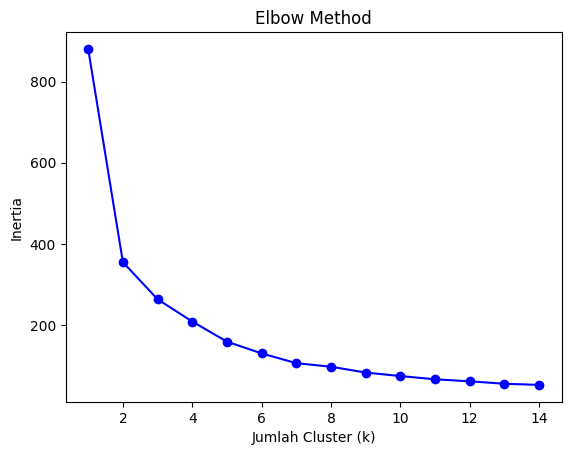

In [ ]:
inertia_list = []
K_range = range(1, 15)
for k in K_range:
    kmeans = KMeans(n_clusters=k, random_state=42).fit(coords)
    inertia_list.append(kmeans.inertia_)

plt.plot(K_range, inertia_list, 'bo-')
plt.xlabel('Jumlah Cluster (k)')
plt.ylabel('Inertia')
plt.title('Elbow Method')
plt.show()


In [ ]:
from sklearn.metrics import silhouette_score

score = silhouette_score(coords, clusters)
print(f'Silhouette Score: {score:.4f}')

Silhouette Score: 0.4210


In [ ]:
for k in range(2, 11):
   model = KMeans(n_clusters=k, random_state=42)
   labels = model.fit_predict(coords)
   score = silhouette_score(coords, labels)
   print(f'K={k}, Silhouette Score={score:.4f}')

K=2, Silhouette Score=0.5063
K=3, Silhouette Score=0.3761
K=4, Silhouette Score=0.3599
K=5, Silhouette Score=0.4031
K=6, Silhouette Score=0.4151
K=7, Silhouette Score=0.4210
K=8, Silhouette Score=0.3901
K=9, Silhouette Score=0.3931
K=10, Silhouette Score=0.3915


In [ ]:
print(df_2022['cluster'].value_counts())

cluster
5.0    14939
3.0    14932
6.0    14579
1.0    10803
0.0    10302
2.0     7550
4.0     5297
Name: count, dtype: int64
